# Initialization

In [1]:
import tensorflow as tf
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt

2024-07-08 15:57:55.841099: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [ ]:
import configs

# Data Loader

In [ ]:
class MyDataGenerator(tf.keras.utils.Sequence):
    def __init__(self, data_dir, batch_size=32, shuffle=True):
        self.batch_size = batch_size
        self.shuffle = shuffle
        self.filenames = glob.glob(data_dir + '/*/*.jpg')
        self.filenames.sort()
        print(len(self.filenames), 'found')
        self.classnames = ['/akiec/', '/bcc/', '/bkl/',
                           '/df/', '/mel/', '/nv/', '/vasc/']
        self.indices = None
        self.on_epoch_end()

    def __len__(self):
        return int(np.ceil(len(self.filenames) / self.batch_size))

    def __getitem__(self, index):
        indices = self.indices[index*self.batch_size:(index+1)*self.batch_size]
        filenames = [self.filenames[k] for k in indices]
        X, Y = self.__data_generation(filenames)
        return X, Y

    def on_epoch_end(self):
        self.indices = np.arange(len(self.filenames))
        if self.shuffle == True:
            np.random.shuffle(self.indices)

    def filename2onehot(self, fn):
        for i in range(configs.NUM_CLASS):
            if self.classnames[i] in fn:
                result = np.zeros(configs.NUM_CLASS, dtype=np.float64)
                result[i] = 1
                return result
        return None

    def __data_generation(self, filenames):
        num = len(filenames)
        X = np.empty([num, *configs.IMAGE_SIZE], dtype=np.float64)
        Y_class = np.empty([num, configs.NUM_CLASS])
        for i, fn in enumerate(filenames):
            img = cv2.imread(fn)
            delta = (configs.IMAGE_SIZE[1] - configs.IMAGE_SIZE[0]) // 2
            img = img[:, delta:configs.IMAGE_SIZE[1]-delta-1]
            img = cv2.resize(img, (224, 224))
            X[i] = np.array(img, dtype=np.float64) / 255.
            Y_class[i] = self.filename2onehot(fn)

        return X, {'out_img':X, 'out_class':Y_class}

In [ ]:
train_datagen = MyDataGenerator(configs.DATA_DIR+'/train', shuffle=False)
val_datagen = MyDataGenerator(configs.DATA_DIR+'/val', shuffle=False)
test_datagen = MyDataGenerator(configs.DATA_DIR+'/test', shuffle=False)

5005 found
2000 found
3010 found


In [ ]:
X, Y = train_datagen[0]

(32, 224, 224, 3)


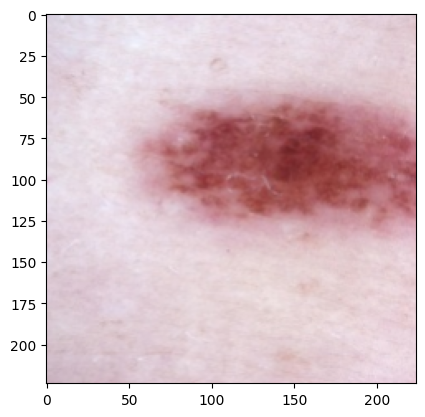

In [ ]:
print(X.shape)
plt.imshow(cv2.cvtColor((X[0]*255).astype(np.uint8), cv2.COLOR_BGR2RGB))
plt.show()

# Noising latent vectors

In [ ]:
def double_conv_block(x, n_filters):
    x = tf.keras.layers.Conv2D(n_filters, 3, padding="same",
                        activation="relu", kernel_initializer="he_normal")(x)
    x = tf.keras.layers.Conv2D(n_filters, 3, padding="same", activation="relu",
                        kernel_initializer="he_normal")(x)
    return x

def downsample_block(x, n_filters):
    f = double_conv_block(x, n_filters)
    p = tf.keras.layers.MaxPool2D(2)(f)
    p = tf.keras.layers.Dropout(0.5)(p)
    return f, p

def upsample_block(x, conv_features, n_filters):
    x = tf.keras.layers.Conv2DTranspose(n_filters, 3, 2, padding="same")(x)
    x = tf.keras.layers.concatenate([x, conv_features])
    x = tf.keras.layers.Dropout(0.5)(x)
    x = double_conv_block(x, n_filters)
    return x

def build_generator_model(input_shape, name):
    inputs = tf.keras.layers.Input(shape=input_shape)

    f1, p1 = downsample_block(inputs, 64)
    f2, p2 = downsample_block(p1, 128)
    f3, p3 = downsample_block(p2, 256)
    # f4, p4 = downsample_block(p3, 512)

    bottleneck = double_conv_block(p3, 512)
    inputs_noise = tf.keras.layers.Input(shape=bottleneck.shape[1:])
    bottleneck = tf.math.multiply(bottleneck, inputs_noise)

    # u6 = upsample_block(bottleneck, f4, 512)
    u7 = upsample_block(bottleneck, f3, 256)
    u8 = upsample_block(u7, f2, 128)
    u9 = upsample_block(u8, f1, 64)

    # outputs_img
    outputs_img = tf.keras.layers.Conv2D(3, 1, padding="same",
                            activation = "sigmoid", name="out_img")(u9)

    # outputs_class
    gap = tf.keras.layers.GlobalAveragePooling2D()(bottleneck)
    d1 = tf.keras.layers.Dense(256, activation='sigmoid')(gap)
    drop1 = tf.keras.layers.Dropout(0.5)(d1)
    d2 = tf.keras.layers.Dense(64, activation='sigmoid')(drop1)
    drop2 = tf.keras.layers.Dropout(0.5)(d2)
    d3 = tf.keras.layers.Dense(7, activation='sigmoid')(drop2)
    outputs_class = tf.keras.layers.Softmax(name="out_class")(d3)

    # unet model with Keras Functional API
    unet_model = tf.keras.Model([inputs, inputs_noise], outputs=[outputs_img, outputs_class],
                                name=name)

    return unet_model

In [ ]:
model = build_generator_model(configs.IMAGE_SIZE, 'generator')
model.summary()

In [ ]:
model.load_weights(configs.CGUNET_CHECKPOINT)

1/1 [==============================] - 1s 1s/step
[0.11359289 0.11452492 0.12058437 0.11351945 0.11577114 0.30849764
 0.11350956]
5


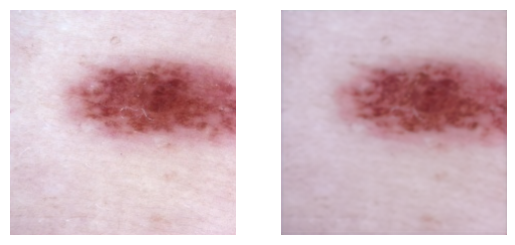

825.6742952854063
1/1 [==============================] - 1s 962ms/step
[0.11359289 0.11452492 0.12058437 0.11351945 0.11577114 0.30849764
 0.11350956]
5


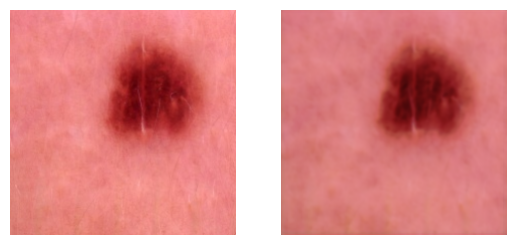

10796.446383968449
1/1 [==============================] - 1s 938ms/step
[0.11359289 0.11452492 0.12058437 0.11351945 0.11577114 0.30849764
 0.11350956]
5


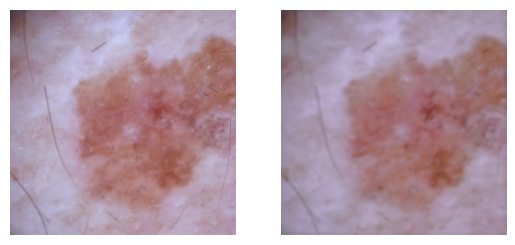

8643.790861956704
1/1 [==============================] - 1s 959ms/step
[0.11359289 0.11452492 0.12058437 0.11351945 0.11577114 0.30849764
 0.11350956]
5


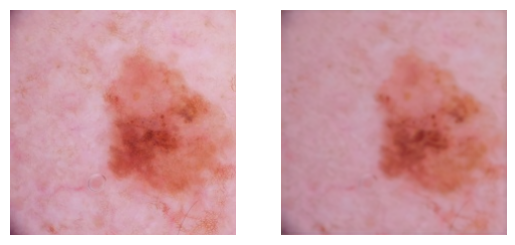

7336.324992309642
1/1 [==============================] - 2s 2s/step
[0.11359289 0.11452492 0.12058437 0.11351945 0.11577114 0.30849764
 0.11350956]
5


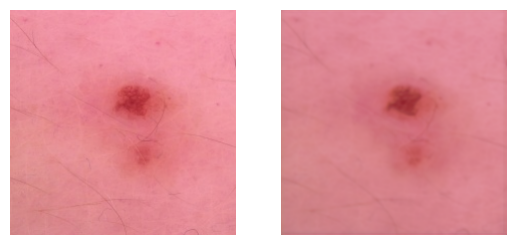

7899.488222388969
1/1 [==============================] - 1s 949ms/step
[0.11359289 0.11452492 0.12058437 0.11351945 0.11577114 0.30849764
 0.11350956]
5


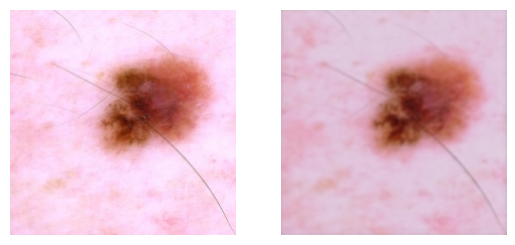

1964.6352781306985


In [ ]:
for index in range(6):
  inputs = [X[index:index+1], np.zeros([1, 28, 28, 512])]
  outputs = model.predict(inputs)

  output_img = outputs[0][0]
  output_class = outputs[1]

  print(output_class[0])
  print(output_class.argmax())
  plt.subplot(1, 2, 1)
  plt.axis('off')
  plt.imshow(cv2.cvtColor((X[index]*255).astype(np.uint8), cv2.COLOR_BGR2RGB))
  plt.subplot(1, 2, 2)
  plt.axis('off')
  plt.imshow(cv2.cvtColor((output_img*255).astype(np.uint8), cv2.COLOR_BGR2RGB))
  plt.show()
  print(np.sum((X[0]-output_img)**2))

1/1 [==============================] - 1s 1s/step
[0.09723489 0.1303261  0.23101412 0.09435885 0.09681565 0.2559046
 0.09434578]
5


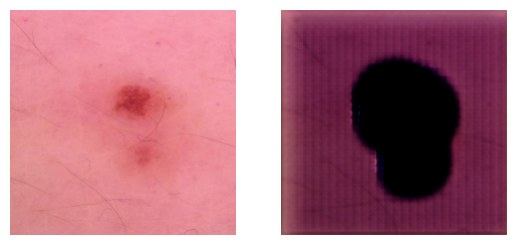

48283.74203393403
1/1 [==============================] - 1s 948ms/step
[0.09762439 0.12765248 0.22939223 0.09507848 0.09726121 0.25792772
 0.09506349]
5


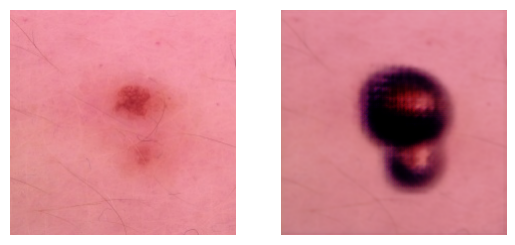

13236.929768425814
1/1 [==============================] - 1s 1s/step
[0.10950506 0.11393379 0.15050784 0.10921277 0.1108933  0.2967439
 0.10920334]
5


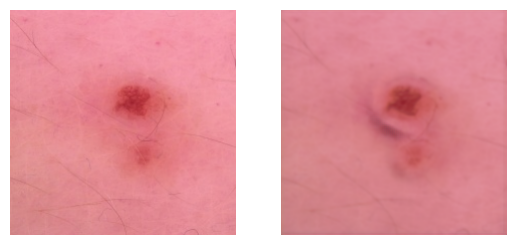

7951.831710311004


In [ ]:
epsilon = -1e-1
index = 4

for exp in range(1, 4):
  epsilon = -10**(-exp)
  inputs = [X[index:index+1], epsilon * np.ones([1, 28, 28, 512])]
  outputs = model.predict(inputs)

  output_img = outputs[0][0]
  output_class = outputs[1]

  print(output_class[0])
  print(output_class.argmax())
  plt.subplot(1, 2, 1)
  plt.axis('off')
  plt.imshow(cv2.cvtColor((X[index]*255).astype(np.uint8), cv2.COLOR_BGR2RGB))
  plt.subplot(1, 2, 2)
  plt.axis('off')
  plt.imshow(cv2.cvtColor((output_img*255).astype(np.uint8), cv2.COLOR_BGR2RGB))
  plt.show()
  print(np.sum((X[0]-output_img)**2))

[0.09710672 0.1316077  0.23165834 0.09404352 0.09652552 0.25502568
 0.09403252]
5


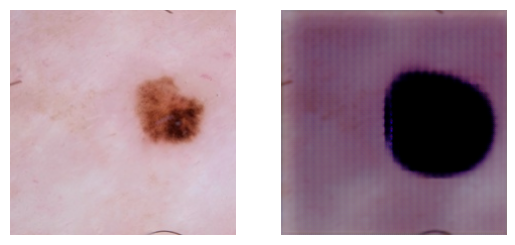

22599.692799352273
[0.09711009 0.13159212 0.23161876 0.09405273 0.09653415 0.25505066
 0.09404145]
5


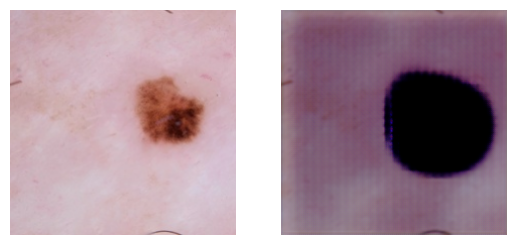

21067.333681676384
[0.0971145  0.13156897 0.23157568 0.09406383 0.09654381 0.25508094
 0.09405226]
5


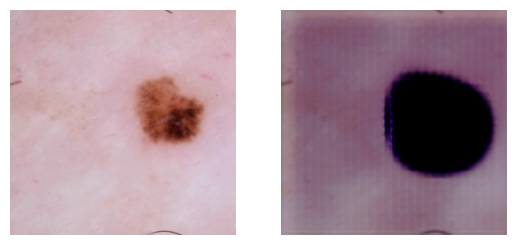

19777.83590632812
[0.09712012 0.13153619 0.23152962 0.09407707 0.0965545  0.25511727
 0.09406521]
5


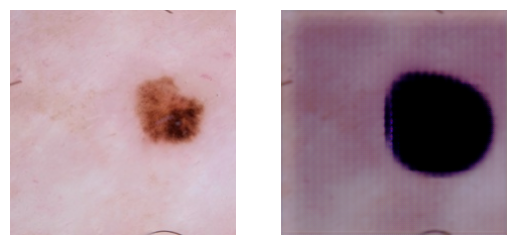

18602.699683219857
[0.09712713 0.13149135 0.231481   0.09409283 0.09656625 0.25516075
 0.09408066]
5


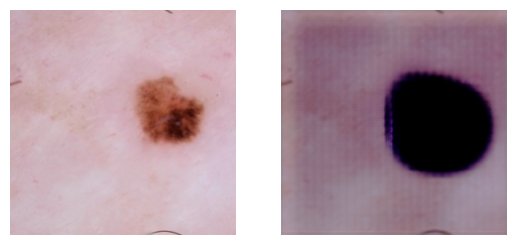

17482.694184190586
[0.09713578 0.13143155 0.2314302  0.09411155 0.09657922 0.25521263
 0.09409906]
5


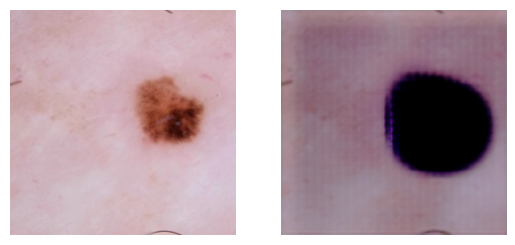

16431.539222060084
[0.09714634 0.13135375 0.23137735 0.09413376 0.0965935  0.25527442
 0.09412091]
5


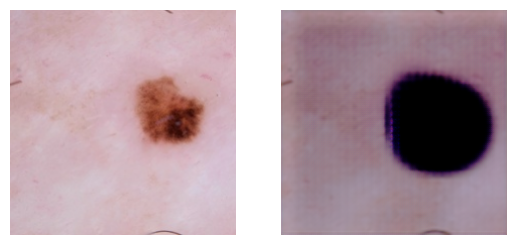

15479.101018971305
[0.09715904 0.13125491 0.23132262 0.09415992 0.09660926 0.25534752
 0.09414672]
5


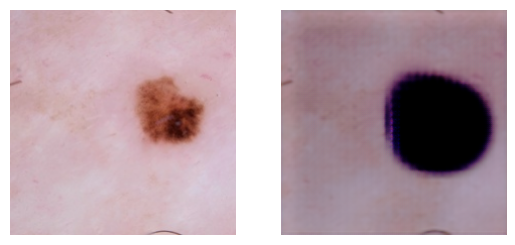

14658.833297655841
[0.09717424 0.13113217 0.23126592 0.09419055 0.09662674 0.25543338
 0.09417699]
5


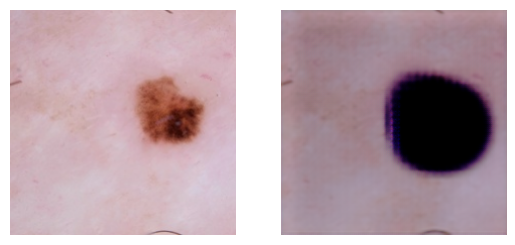

13954.516500333384
[0.09719221 0.13098295 0.23120715 0.09422611 0.09664612 0.25553328
 0.0942122 ]
5


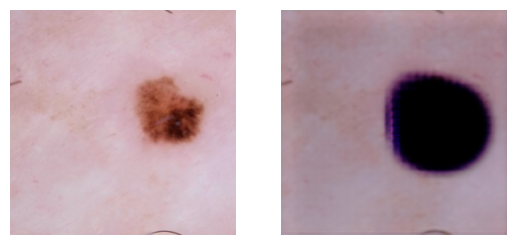

13322.999150546662
[0.09721327 0.13080493 0.23114587 0.09426701 0.0966677  0.25564843
 0.09425277]
5


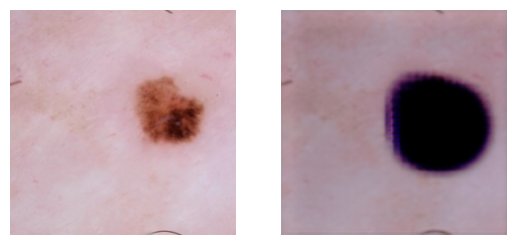

12752.280550541433
[0.0972377  0.13059604 0.23108129 0.09431372 0.09669189 0.25578013
 0.09429918]
5


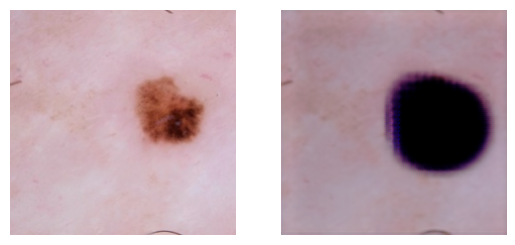

12228.235555885647
[0.09726585 0.13035423 0.2310116  0.09436685 0.09671936 0.2559301
 0.09435204]
5


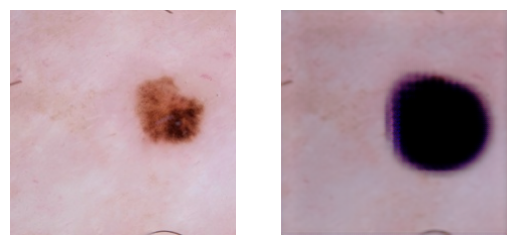

11735.882939705478
[0.09729809 0.13007723 0.23093356 0.09442724 0.09675107 0.25610062
 0.09441222]
5


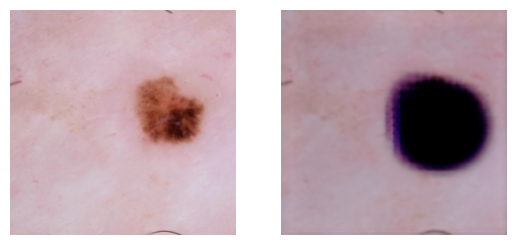

11264.194865763353
[0.09733489 0.12976217 0.23084214 0.09449612 0.09678841 0.25629526
 0.09448093]
5


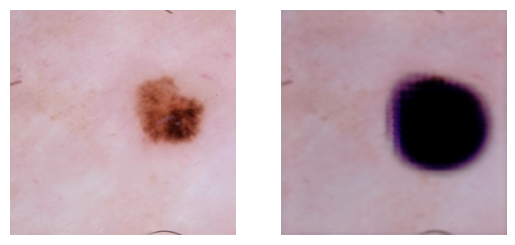

10821.57354094821
[0.09737702 0.1294051  0.23072991 0.09457535 0.09683339 0.25651917
 0.09456003]
5


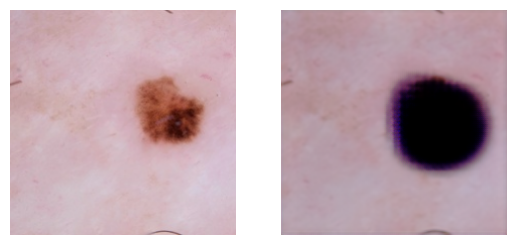

10387.955022941122
[0.09742556 0.12900029 0.2305864  0.09466748 0.0968887  0.2567795
 0.09465209]
5


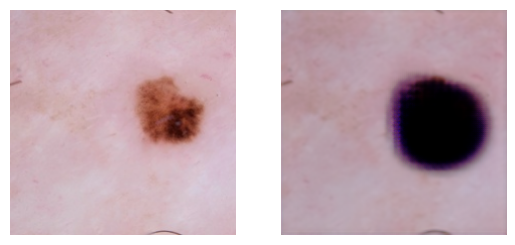

9954.167791197748
[0.09748217 0.12853992 0.23039737 0.09477599 0.09695788 0.25708595
 0.09476062]
5


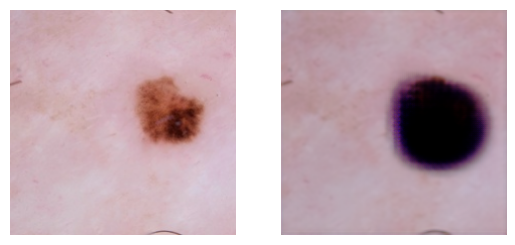

9495.612218923095
[0.09754934 0.12801372 0.23014404 0.09490551 0.09704564 0.2574515
 0.09489026]
5


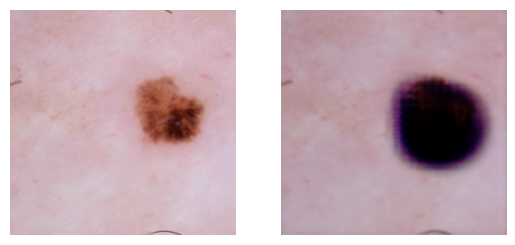

8961.662746410959
[0.09763069 0.12740895 0.22980104 0.09506196 0.0971579  0.2578925
 0.09504695]
5


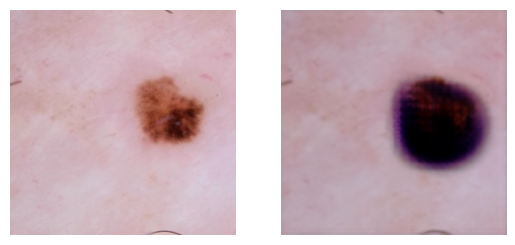

8284.26140232394
[0.09773132 0.1267114  0.22933494 0.09525277 0.09730218 0.25842926
 0.09523813]
5


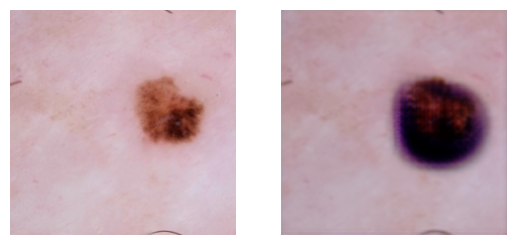

7466.764818783134
[0.09785824 0.12590668 0.22870113 0.09548692 0.09748771 0.25908655
 0.09547278]
5


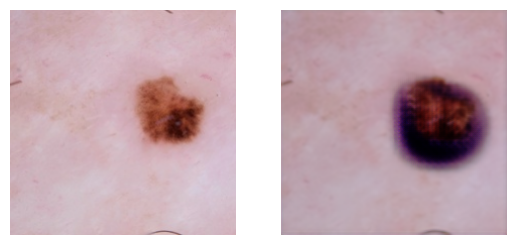

6595.324141383611


In [ ]:
index = 1

for exp in np.arange(1.0, 2.1, 0.05):
  epsilon = -10**(-exp)
  inputs = [X[index:index+1], epsilon * np.ones([1, 28, 28, 512])]
  outputs = model.predict(inputs, verbose=0)

  output_img = outputs[0][0]
  output_class = outputs[1]

  print(output_class[0])
  print(output_class.argmax())
  plt.subplot(1, 2, 1)
  plt.axis('off')
  plt.imshow(cv2.cvtColor((X[index]*255).astype(np.uint8), cv2.COLOR_BGR2RGB))
  plt.subplot(1, 2, 2)
  plt.axis('off')
  plt.imshow(cv2.cvtColor((output_img*255).astype(np.uint8), cv2.COLOR_BGR2RGB))
  plt.show()
  print(np.sum((X[0]-output_img)**2))

[0.09693752 0.13364671 0.23224004 0.09361055 0.09615421 0.25381073
 0.09360024]
5


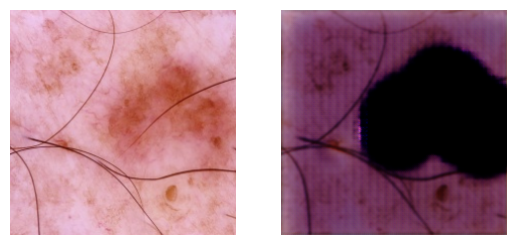

37456.11918227447
[0.09694017 0.13361187 0.23223485 0.09361722 0.09615963 0.25382942
 0.0936069 ]
5


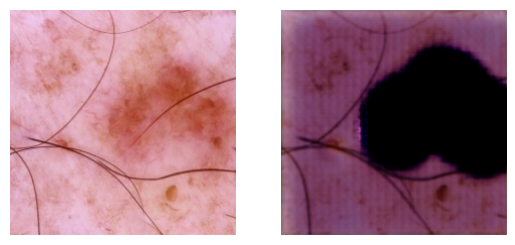

34979.19838165321
[0.09694365 0.13356622 0.23222782 0.09362596 0.09616676 0.25385392
 0.09361564]
5


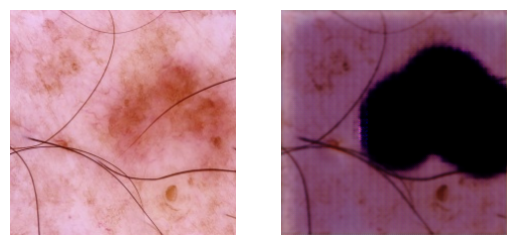

33043.436139502875
[0.09694802 0.13350928 0.23221876 0.09363695 0.09617572 0.25388464
 0.0936266 ]
5


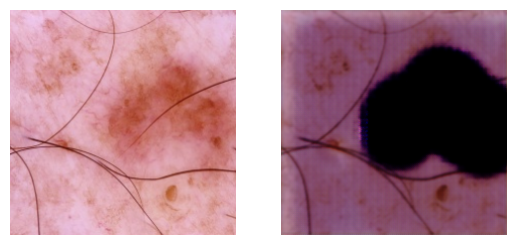

31462.588330643444
[0.09695324 0.13344145 0.23220745 0.09365011 0.09618651 0.2539215
 0.09363972]
5


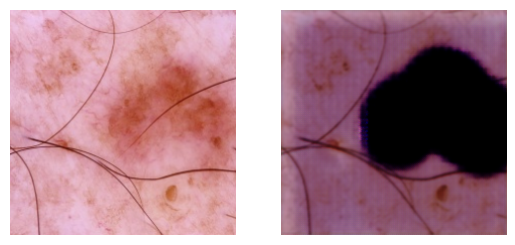

30054.945894235512
[0.09695924 0.13336398 0.2321938  0.09366526 0.09619895 0.25396392
 0.09365483]
5


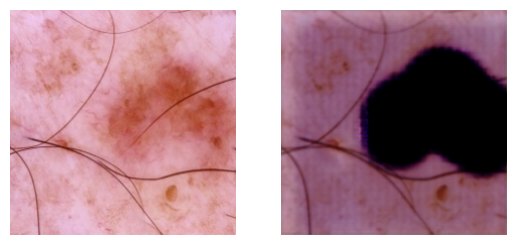

28699.983636001718
[0.09696588 0.13327883 0.23217803 0.09368204 0.09621277 0.25401092
 0.09367155]
5


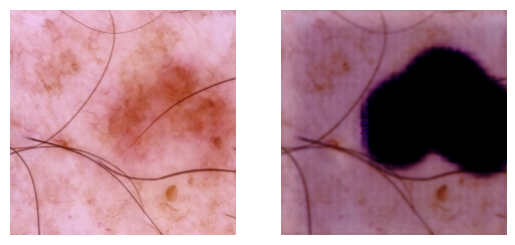

27380.7158404926
[0.09697299 0.13318856 0.23216042 0.09369998 0.09622753 0.2540611
 0.0936894 ]
5


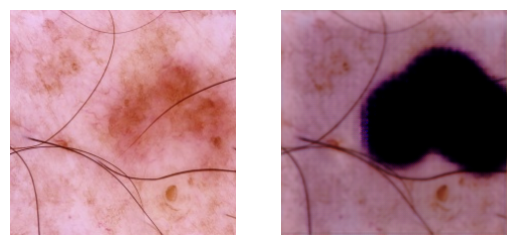

26197.15359662847
[0.09698044 0.13309592 0.23214169 0.09371851 0.0962427  0.25411293
 0.09370781]
5


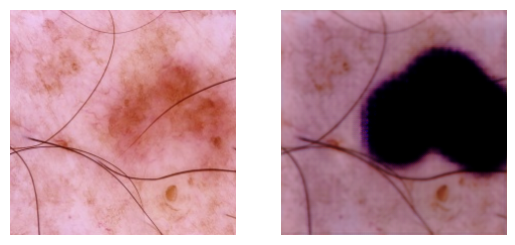

25156.747432747663
[0.09698807 0.13300356 0.23212272 0.09373704 0.09625766 0.2541648
 0.09372617]
5


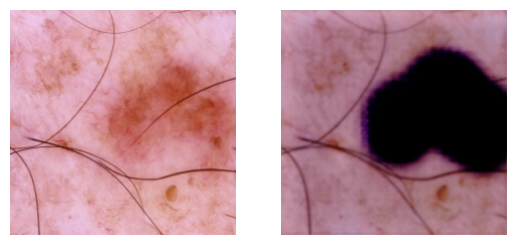

24237.812974560773
[0.0969958  0.1329136  0.2321047  0.09375507 0.09627172 0.25421512
 0.09374398]
5


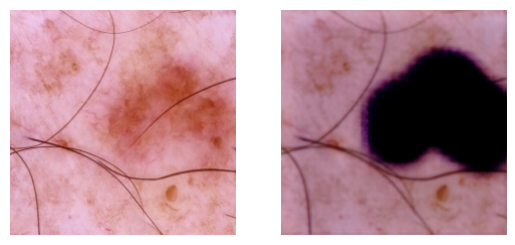

23440.921601120575
[0.09700365 0.13282727 0.23208894 0.09377217 0.09628427 0.2542629
 0.09376082]
5


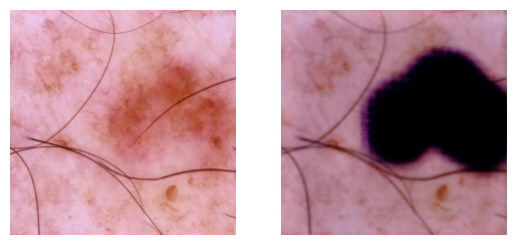

22728.736849324232
[0.09701169 0.13274458 0.23207672 0.09378821 0.09629473 0.25430757
 0.09377652]
5


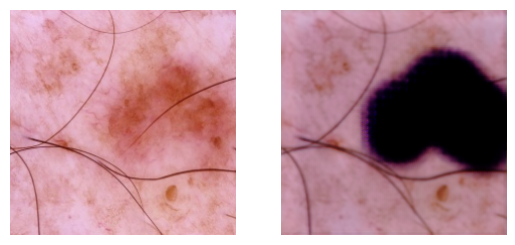

22038.597068993437
[0.09702009 0.13266411 0.23206922 0.09380323 0.0963027  0.25434947
 0.09379119]
5


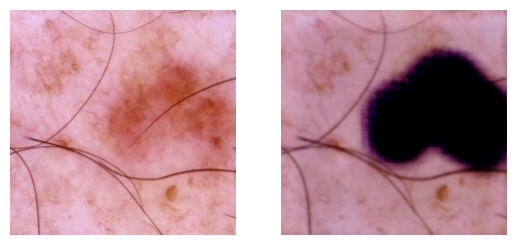

21347.718800665203
[0.09702915 0.132583   0.23206733 0.09381765 0.09630802 0.2543897
 0.09380522]
5


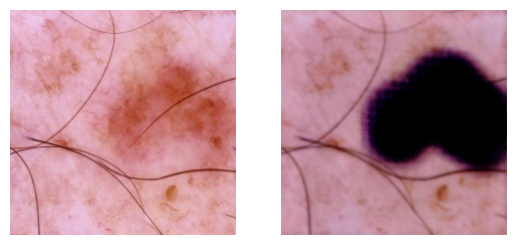

20682.412932824995
[0.09703913 0.13249703 0.23207147 0.09383214 0.09631078 0.25443017
 0.09381928]
5


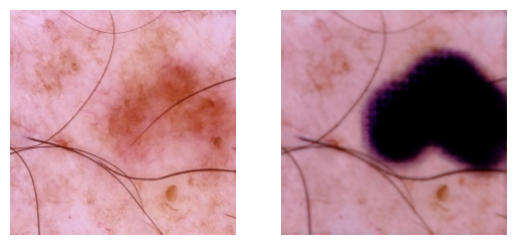

20034.387213563237
[0.09705044 0.13240105 0.23208156 0.09384764 0.0963114  0.25447363
 0.09383431]
5


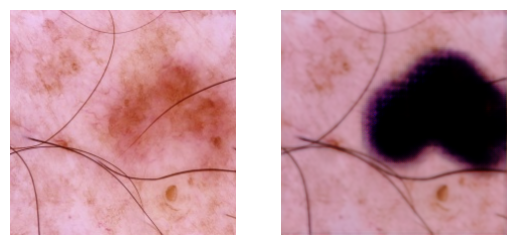

19384.650265330372
[0.09706342 0.13228913 0.23209673 0.0938653  0.09631066 0.25452325
 0.09385151]
5


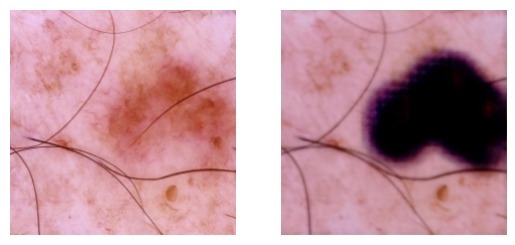

18674.851422402073
[0.09707849 0.13215515 0.23211507 0.09388644 0.09630967 0.25458297
 0.0938722 ]
5


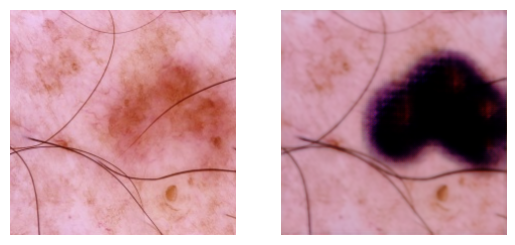

17813.591177491708
[0.09709608 0.1319927  0.23213352 0.09391263 0.09630995 0.25465715
 0.09389795]
5


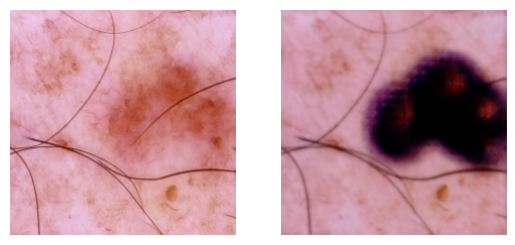

16661.460230130822
[0.09711666 0.13179527 0.23214753 0.09394566 0.09631342 0.2547509
 0.09393053]
5


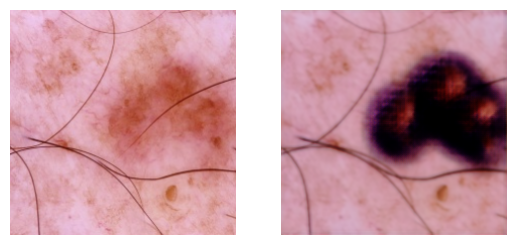

15135.452237226467
[0.09714079 0.13155587 0.232151   0.09398764 0.09632241 0.2548702
 0.0939721 ]
5


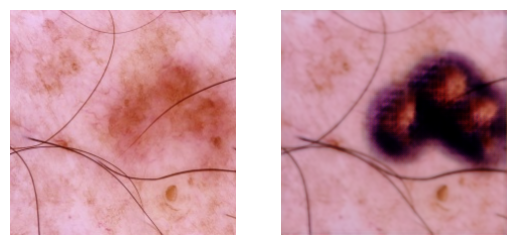

13293.602145205385


In [ ]:
index = 5

for exp in np.arange(1.0, 2.1, 0.05):
  epsilon = -10**(-exp)
  inputs = [X[index:index+1], epsilon * np.ones([1, 28, 28, 512])]
  outputs = model.predict(inputs, verbose=0)
  output_img = outputs[0][0]
  output_class = outputs[1]

  print(output_class[0])
  print(output_class.argmax())
  plt.subplot(1, 2, 1)
  plt.axis('off')
  plt.imshow(cv2.cvtColor((X[index]*255).astype(np.uint8), cv2.COLOR_BGR2RGB))
  plt.subplot(1, 2, 2)
  plt.axis('off')
  plt.imshow(cv2.cvtColor((output_img*255).astype(np.uint8), cv2.COLOR_BGR2RGB))
  plt.show()
  print(np.sum((X[0]-output_img)**2))

[0.11414408 0.11430082 0.11463825 0.11414012 0.11846218 0.3101872
 0.11412734]
5


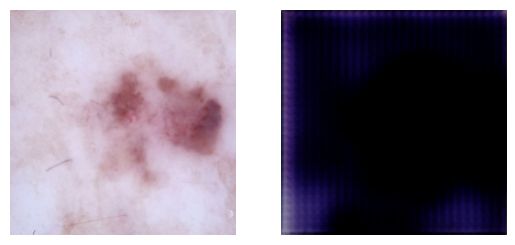

65120.9735298873
[0.11414521 0.11430226 0.11464041 0.11414119 0.1184523  0.31019017
 0.11412843]
5


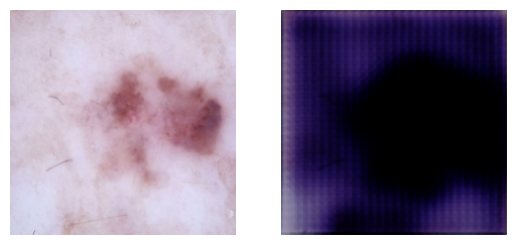

54581.17506377776
[0.11414685 0.11430497 0.114645   0.11414268 0.11843611 0.3101944
 0.11412996]
5


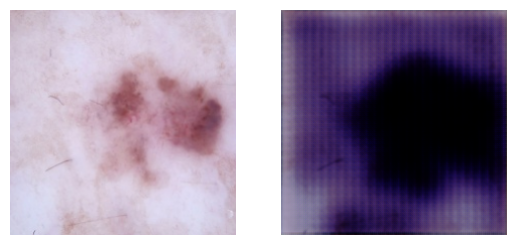

40555.246462518684
[0.11414909 0.1143095  0.11465406 0.11414465 0.11841067 0.3102
 0.11413201]
5


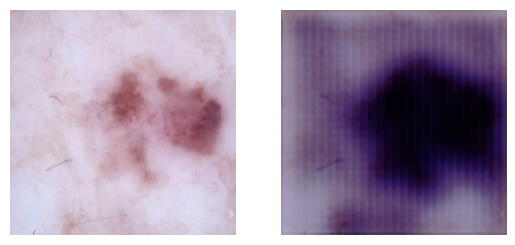

27094.230117457093
[0.1141523  0.11431688 0.11467098 0.11414735 0.11836978 0.31020778
 0.11413487]
5


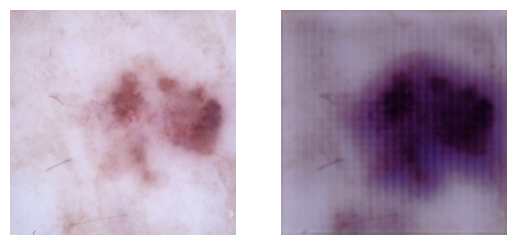

15611.821108706894
[0.11415794 0.11433009 0.11470526 0.11415183 0.11829425 0.31022102
 0.11413968]
5


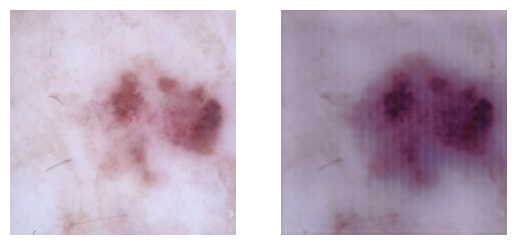

8399.830447629918
[0.11416882 0.11435651 0.11478488 0.11416034 0.11813451 0.31024614
 0.11414877]
5


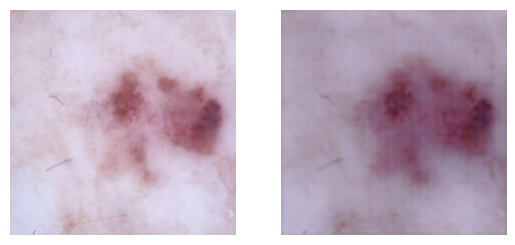

5343.634987419834
[0.11418284 0.11440347 0.11496438 0.11417007 0.1178444  0.31027552
 0.11415932]
5


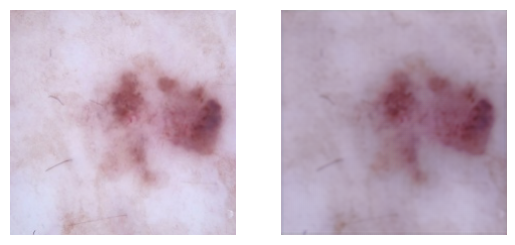

3957.396630715727
[0.11418252 0.11446562 0.11531912 0.1141631  0.11745744 0.310259
 0.11415321]
5


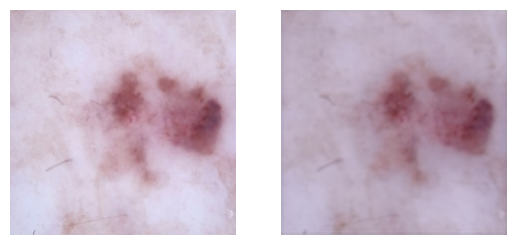

3400.8895216815563
[0.11414456 0.11452298 0.11591221 0.11411639 0.11706461 0.31013227
 0.11410701]
5


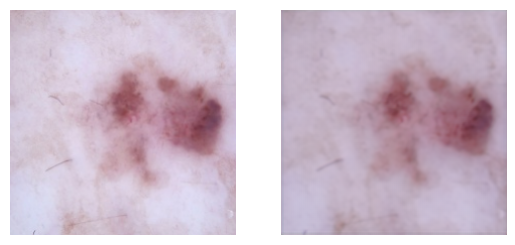

3218.362971985837
[0.11406506 0.11455873 0.11672103 0.11402709 0.11672246 0.30988783
 0.11401783]
5


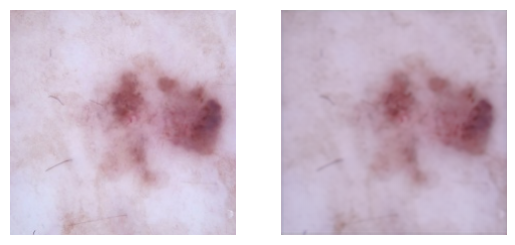

3275.262538528041


In [ ]:
index = 10

for exp in np.arange(0, 2.1, 0.2):
  epsilon = -10**(-exp)
  inputs = [X[index:index+1], epsilon * np.ones([1, 28, 28, 512])]
  outputs = model.predict(inputs, verbose=0)

  output_img = outputs[0][0]
  output_class = outputs[1]

  print(output_class[0])
  print(output_class.argmax())
  plt.subplot(1, 2, 1)
  plt.axis('off')
  plt.imshow(cv2.cvtColor((X[index]*255).astype(np.uint8), cv2.COLOR_BGR2RGB))
  plt.subplot(1, 2, 2)
  plt.axis('off')
  plt.imshow(cv2.cvtColor((output_img*255).astype(np.uint8), cv2.COLOR_BGR2RGB))
  plt.show()
  print(np.sum((X[0]-output_img)**2))

[0.11415777 0.11432422 0.11468098 0.11415263 0.11832258 0.3102217
 0.11414012]
5


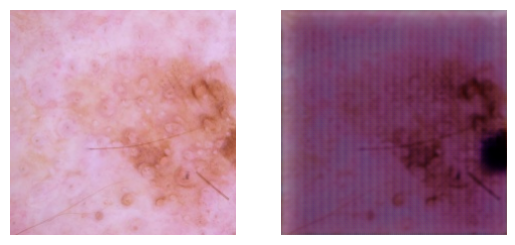

20477.264786744563
[0.1141584  0.11432585 0.11468506 0.11415315 0.11831371 0.31022316
 0.11414067]
5


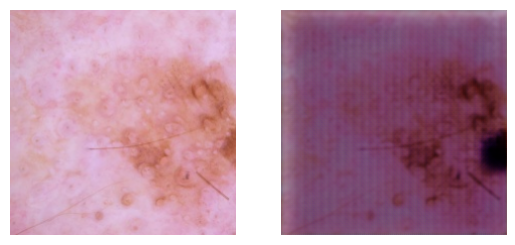

17331.426543637517
[0.11415908 0.11432766 0.11468965 0.11415367 0.118304   0.3102247
 0.11414124]
5


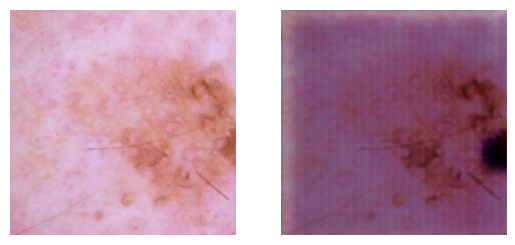

14944.993952662086
[0.11415981 0.1143297  0.11469494 0.11415423 0.11829313 0.31022638
 0.11414186]
5


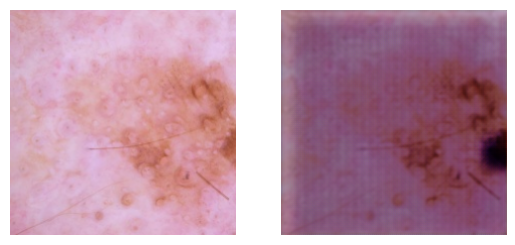

13011.220888264657
[0.11416063 0.11433202 0.11470109 0.11415485 0.11828063 0.3102282
 0.11414253]
5


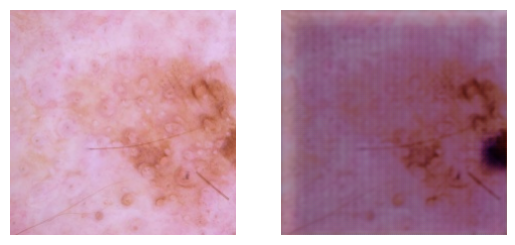

11287.773560959746
[0.11416161 0.11433475 0.11470843 0.11415558 0.11826592 0.3102304
 0.11414334]
5


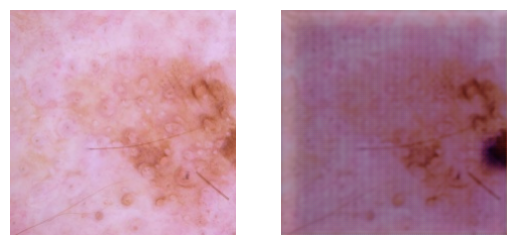

9647.111170315062
[0.11416277 0.11433798 0.11471733 0.11415642 0.11824821 0.31023297
 0.11414428]
5


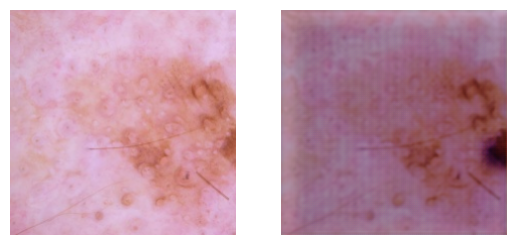

8083.475284559581
[0.1141642  0.11434188 0.11472829 0.11415748 0.11822656 0.3102362
 0.11414544]
5


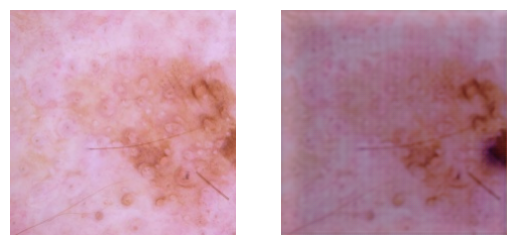

6754.756627704456
[0.11416592 0.11434659 0.11474188 0.11415878 0.11819994 0.3102401
 0.11414686]
5


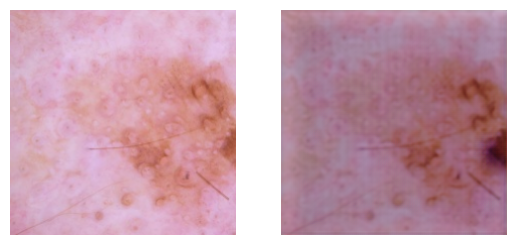

5702.30940573653
[0.11416802 0.11435223 0.11475883 0.11416033 0.11816724 0.31024483
 0.11414856]
5


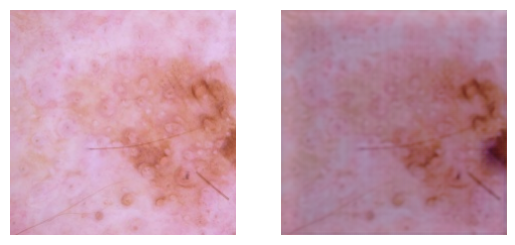

4876.150958441469
[0.11417048 0.114359   0.11477996 0.11416217 0.11812747 0.31025034
 0.11415055]
5


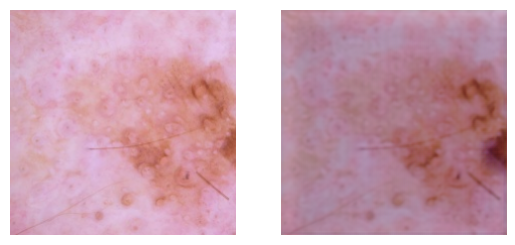

4257.012283316912
[0.11417331 0.11436701 0.11480618 0.11416427 0.1180798  0.31025663
 0.11415283]
5


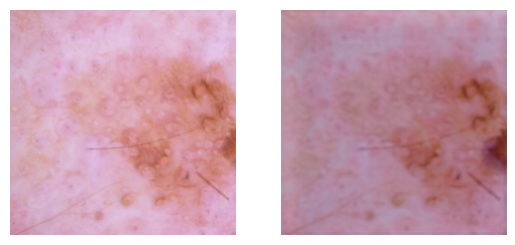

3790.5990736922563
[0.11417639 0.11437634 0.11483852 0.1141665  0.11802364 0.31026343
 0.11415524]
5


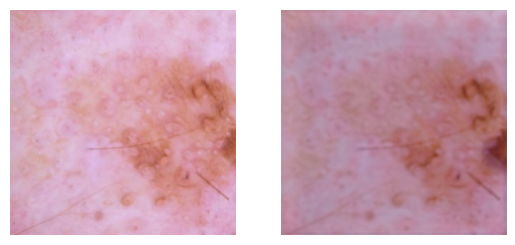

3387.078997309556
[0.11417958 0.11438706 0.11487807 0.1141687  0.11795883 0.3102701
 0.11415765]
5


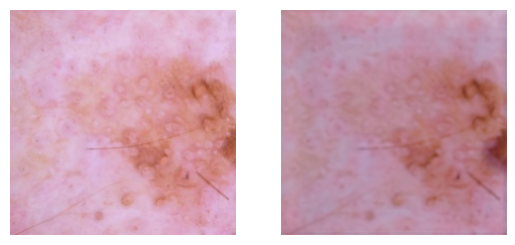

3013.9039876478228
[0.11418263 0.11439911 0.11492606 0.11417063 0.11788563 0.31027615
 0.11415979]
5


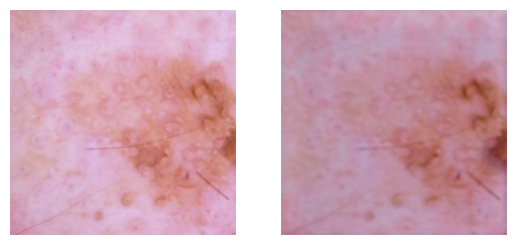

2699.125411535673
[0.11418524 0.11441239 0.11498371 0.11417195 0.11780482 0.31028053
 0.11416135]
5


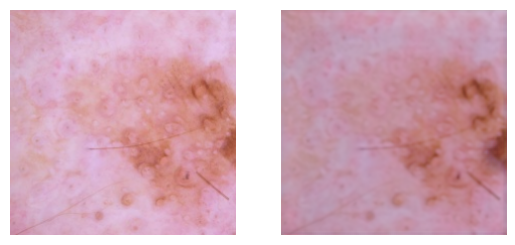

2454.8833155564166
[0.11418699 0.11442668 0.11505234 0.1141723  0.1177175  0.31028223
 0.11416191]
5


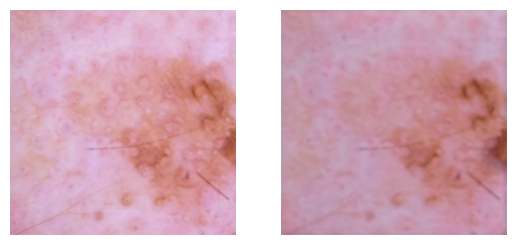

2304.6600107958984
[0.11418752 0.11444175 0.11513323 0.11417125 0.11762514 0.31028005
 0.11416108]
5


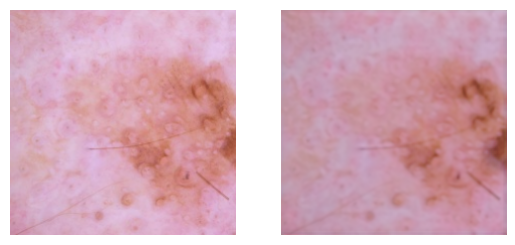

2208.6645458151916
[0.11418632 0.11445724 0.11522757 0.11416835 0.11752935 0.31027278
 0.11415838]
5


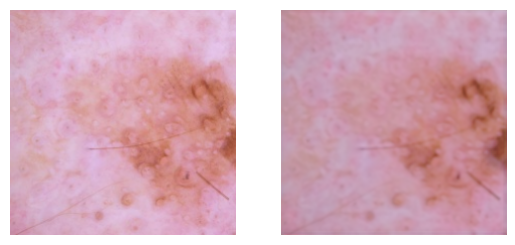

2164.345399554197
[0.11418306 0.11447278 0.11533643 0.11416322 0.11743171 0.31025928
 0.11415344]
5


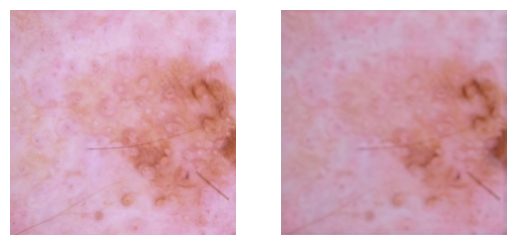

2134.5448255116735
[0.11417739 0.11448804 0.11546066 0.11415555 0.1173337  0.31023872
 0.11414593]
5


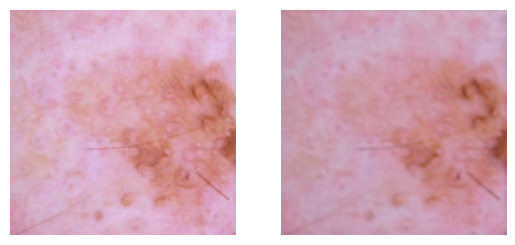

2113.051722193305
[0.11416903 0.11450261 0.11560065 0.11414509 0.11723656 0.31021044
 0.11413561]
5


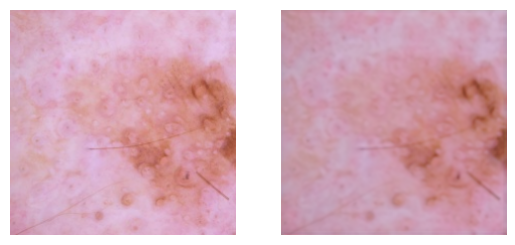

2097.041564839242


In [ ]:
index = 15

for exp in np.arange(1.0, 2.1, 0.05):
  epsilon = -10**(-exp)
  inputs = [X[index:index+1], epsilon * np.ones([1, 28, 28, 512])]
  outputs = model.predict(inputs, verbose=0)

  output_img = outputs[0][0]
  output_class = outputs[1]

  print(output_class[0])
  print(output_class.argmax())
  plt.subplot(1, 2, 1)
  plt.axis('off')
  plt.imshow(cv2.cvtColor((X[index]*255).astype(np.uint8), cv2.COLOR_BGR2RGB))
  plt.subplot(1, 2, 2)
  plt.axis('off')
  plt.imshow(cv2.cvtColor((output_img*255).astype(np.uint8), cv2.COLOR_BGR2RGB))
  plt.show()
  print(np.sum((X[0]-output_img)**2))

[0.11414938 0.11431018 0.11465549 0.11414491 0.11840701 0.31020075
 0.11413228]
5


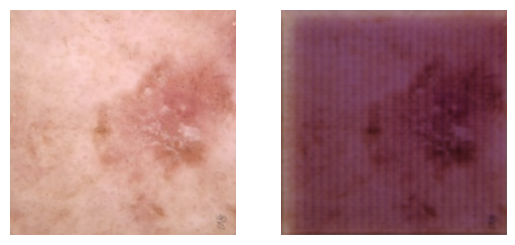

21396.915019038563
[0.1141501  0.11431178 0.11465903 0.11414552 0.11839815 0.31020248
 0.11413293]
5


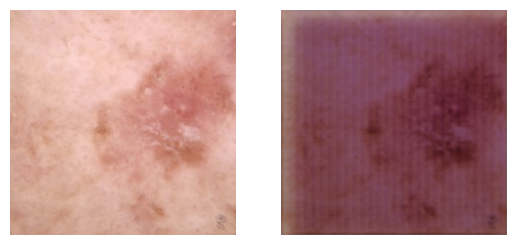

18057.22265119791
[0.11415089 0.11431359 0.11466316 0.11414617 0.11838814 0.3102044
 0.11413363]
5


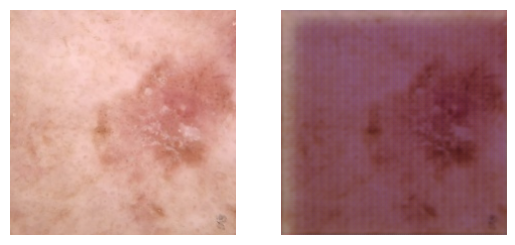

15498.259672015756
[0.11415177 0.11431564 0.11466799 0.11414692 0.11837673 0.31020653
 0.11413441]
5


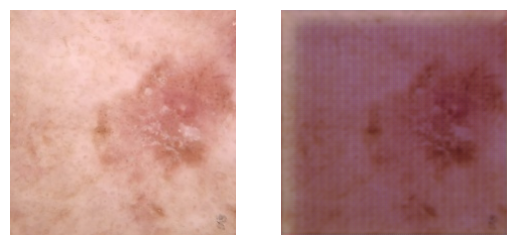

13377.85601890546
[0.11415279 0.11431798 0.1146737  0.11414773 0.1183636  0.3102089
 0.11413527]
5


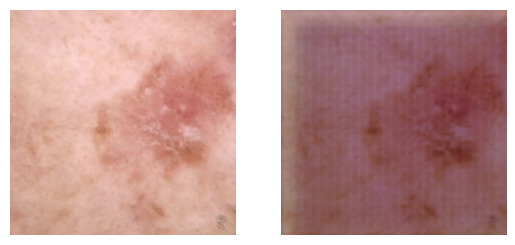

11457.024144234663
[0.11415394 0.11432072 0.11468051 0.11414866 0.11834825 0.31021163
 0.11413628]
5


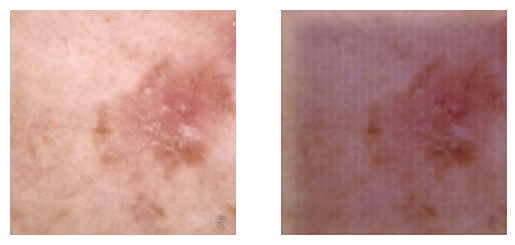

9666.036760007564
[0.11415531 0.11432391 0.11468874 0.11414974 0.11833002 0.31021482
 0.11413744]
5


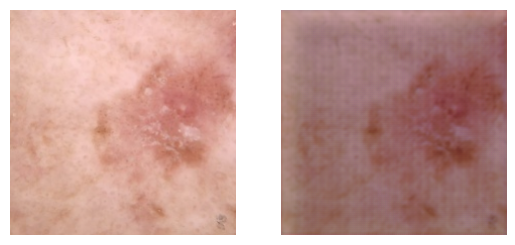

7993.441506001748
[0.11415693 0.11432771 0.11469881 0.11415102 0.11830811 0.31021863
 0.11413882]
5


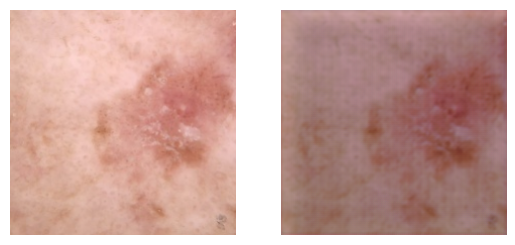

6631.790368325216
[0.11415885 0.11433225 0.11471125 0.11415256 0.11828153 0.3102231
 0.11414045]
5


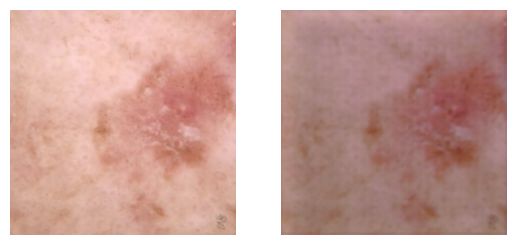

5566.88273692675
[0.11416115 0.11433767 0.11472668 0.11415437 0.11824924 0.3102285
 0.1141424 ]
5


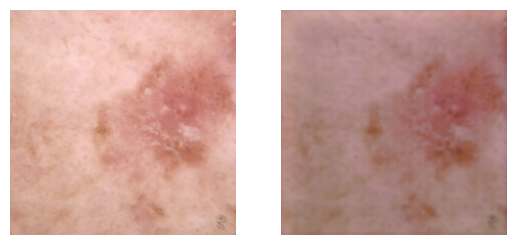

4701.191752333852
[0.11416386 0.11434414 0.11474587 0.11415648 0.1182102  0.31023476
 0.11414466]
5


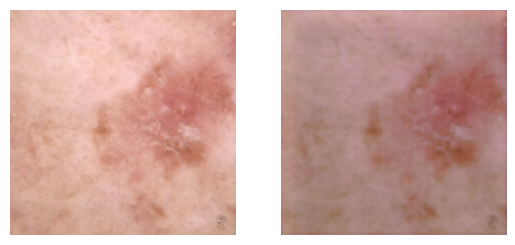

4036.7303417729295
[0.11416698 0.11435179 0.11476967 0.11415893 0.11816347 0.31024194
 0.11414725]
5


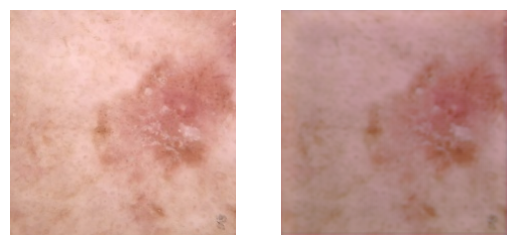

3527.4865161276666
[0.11417043 0.11436075 0.114799   0.11416157 0.11810837 0.3102498
 0.11415008]
5


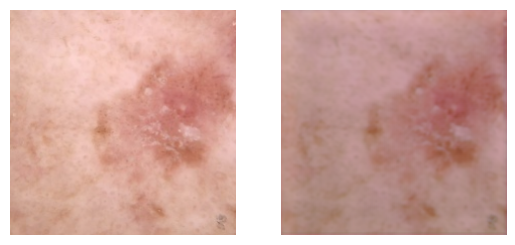

3076.686452194751
[0.11417411 0.1143711  0.11483497 0.11416432 0.11804452 0.31025794
 0.11415301]
5


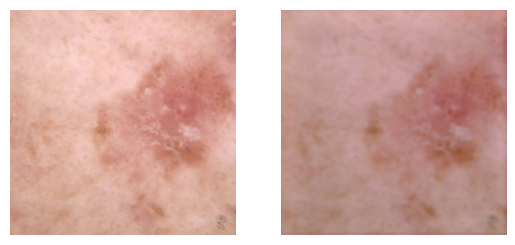

2651.7472749457297
[0.11417779 0.11438282 0.1148787  0.11416696 0.11797202 0.31026584
 0.11415585]
5


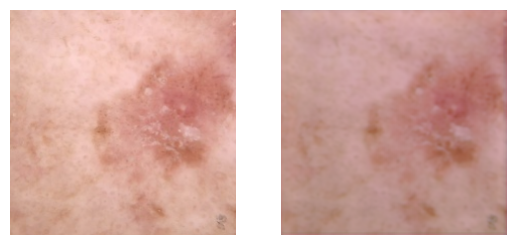

2315.9350311008384
[0.11418121 0.11439586 0.11493141 0.11416915 0.1178914  0.31027263
 0.11415829]
5


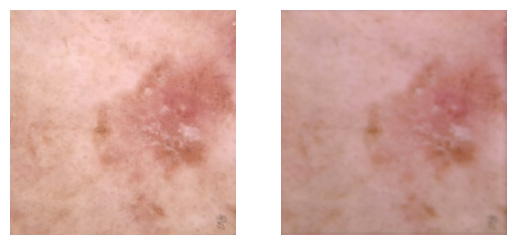

2062.360557462126
[0.11418401 0.11441007 0.1149944  0.1141706  0.11780366 0.3102773
 0.11415996]
5


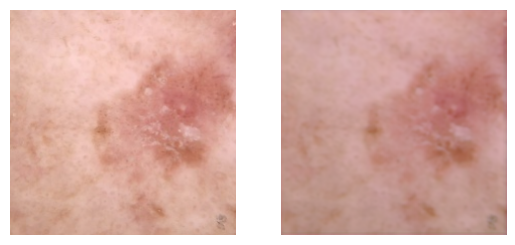

1907.7032887847404
[0.11418575 0.11442518 0.11506893 0.11417083 0.11771017 0.31027868
 0.11416042]
5


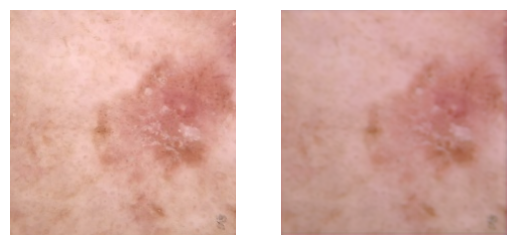

1800.833179640638
[0.11418601 0.11444092 0.11515631 0.11416944 0.11761254 0.3102755
 0.11415924]
5


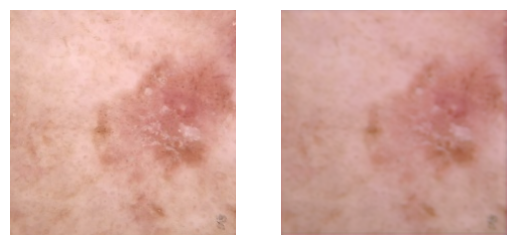

1756.3787241019274
[0.11418436 0.11445692 0.11525767 0.11416598 0.11751246 0.31026664
 0.114156  ]
5


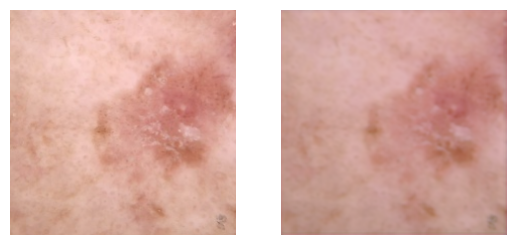

1729.1263997737149
[0.11418042 0.11447279 0.11537395 0.11416009 0.11741145 0.31025097
 0.11415028]
5


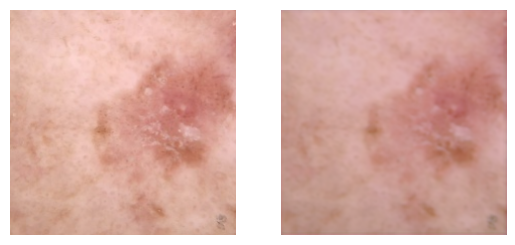

1711.0897198985606
[0.11417388 0.11448818 0.11550584 0.11415148 0.11731097 0.31022778
 0.11414181]
5


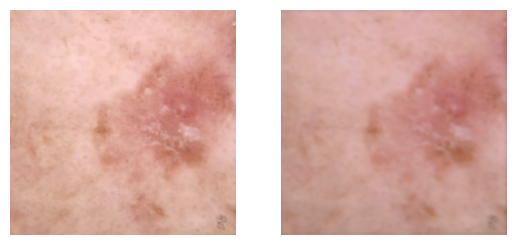

1694.5803718865711


In [ ]:
index = 20

for exp in np.arange(1.0, 2.1, 0.05):
  epsilon = -10**(-exp)
  inputs = [X[index:index+1], epsilon * np.ones([1, 28, 28, 512])]
  outputs = model.predict(inputs, verbose=0)

  output_img = outputs[0][0]
  output_class = outputs[1]

  print(output_class[0])
  print(output_class.argmax())
  plt.subplot(1, 2, 1)
  plt.axis('off')
  plt.imshow(cv2.cvtColor((X[index]*255).astype(np.uint8), cv2.COLOR_BGR2RGB))
  plt.subplot(1, 2, 2)
  plt.axis('off')
  plt.imshow(cv2.cvtColor((output_img*255).astype(np.uint8), cv2.COLOR_BGR2RGB))
  plt.show()
  print(np.sum((X[0]-output_img)**2))

[0.10021634 0.11942174 0.2136543  0.09882396 0.1007945  0.268279
 0.09881018]
5


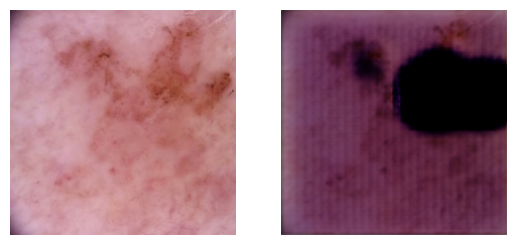

32837.26698302254
[0.10029358 0.11929368 0.21313603 0.09892333 0.10089089 0.2685528
 0.09890962]
5


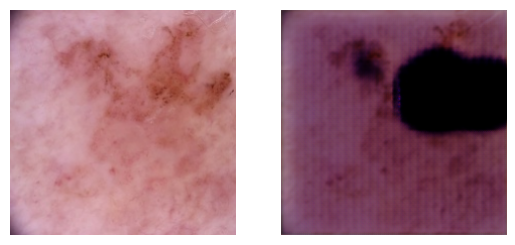

29873.758054469614
[0.10037218 0.11916929 0.21260321 0.09902421 0.1009896  0.2688309
 0.09901059]
5


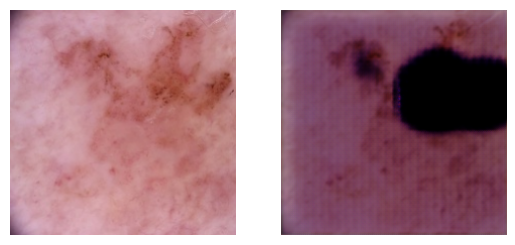

27525.389915269694
[0.10045167 0.11904779 0.21206033 0.09912603 0.10108988 0.26911172
 0.09911258]
5


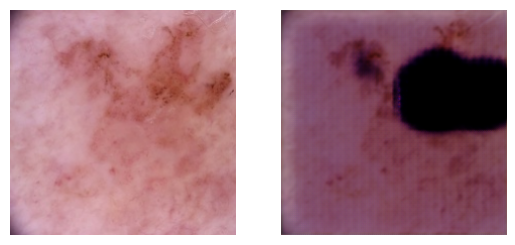

25641.85793857571
[0.10053195 0.11892769 0.2115096  0.09922875 0.10119133 0.26939514
 0.09921549]
5


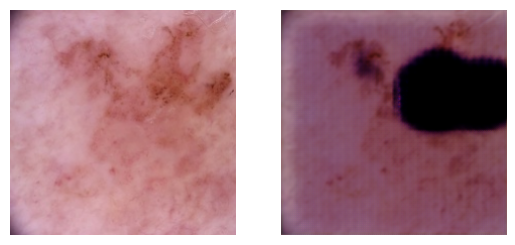

24069.618278571714
[0.10061334 0.11880713 0.21095097 0.09933271 0.10129397 0.26968217
 0.09931969]
5


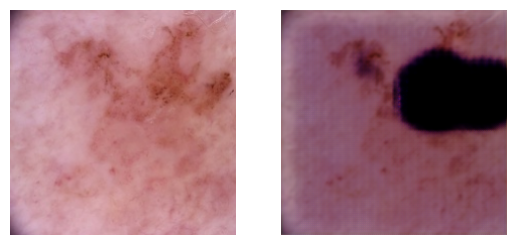

22627.87931711599
[0.10069643 0.1186841  0.21038234 0.09943862 0.10139804 0.2699746
 0.09942587]
5


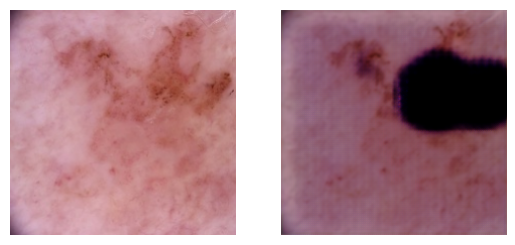

21221.126554617855
[0.10078203 0.11855671 0.20980018 0.09954733 0.10150404 0.27027482
 0.09953491]
5


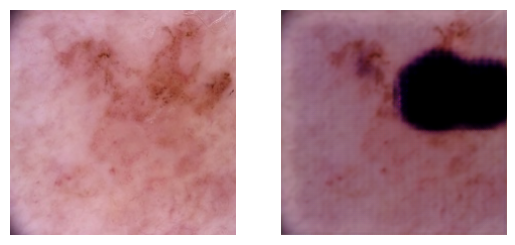

19936.21226389135
[0.10087108 0.11842341 0.20919998 0.09965981 0.10161249 0.27058548
 0.09964777]
5


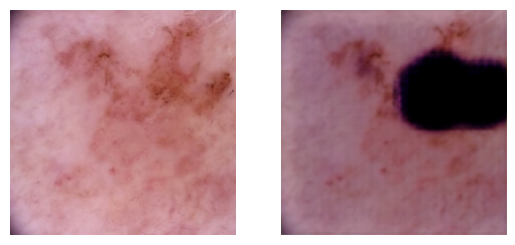

18778.930304643014
[0.10096462 0.11828285 0.2085764  0.09977713 0.10172408 0.27090946
 0.09976549]
5


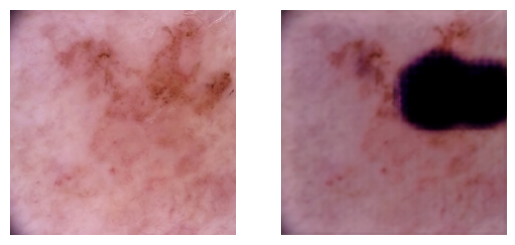

17733.045970690924
[0.10106392 0.11813389 0.20792234 0.09990059 0.10183973 0.2712502
 0.09988937]
5


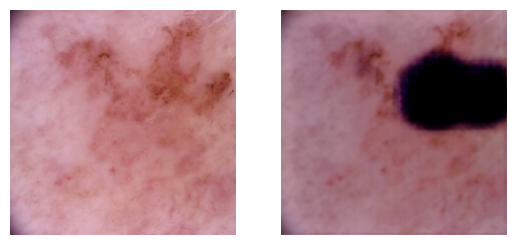

16821.678998515374
[0.1011708  0.11797499 0.2072269  0.10003208 0.10196099 0.27161294
 0.10002131]
5


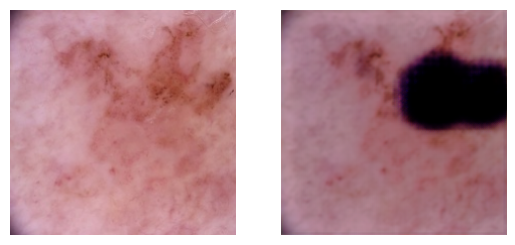

16023.512476000355
[0.10128803 0.11780386 0.20647216 0.10017473 0.10209063 0.27200618
 0.1001644 ]
5


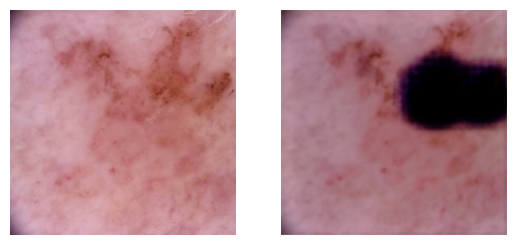

15252.166876167264
[0.1014199  0.1176171  0.20562913 0.10033344 0.10223335 0.27244353
 0.10032355]
5


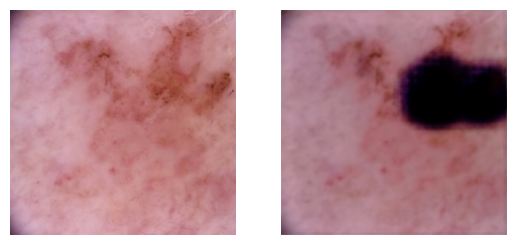

14475.515062484268
[0.10157284 0.11741013 0.20465401 0.10051554 0.10239635 0.27294508
 0.10050607]
5


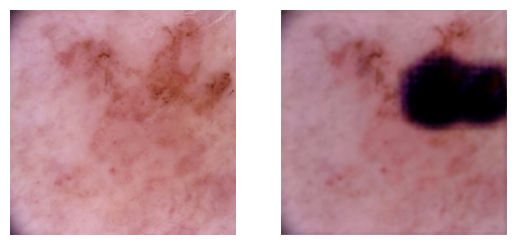

13692.73942670255
[0.10175559 0.11717762 0.20348601 0.10073104 0.10258968 0.27353814
 0.10072194]
5


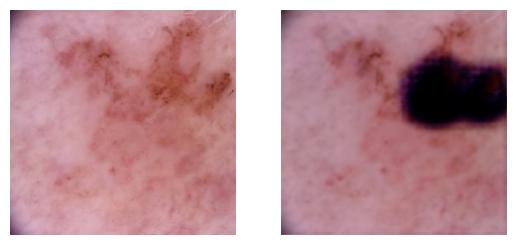

12916.112196111819
[0.10197925 0.11691466 0.20204735 0.10099234 0.10282611 0.27425677
 0.10098357]
5


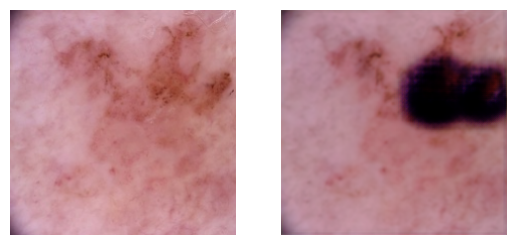

12152.84825291393
[0.10225669 0.11661844 0.20024653 0.10131352 0.10312036 0.27513942
 0.10130504]
5


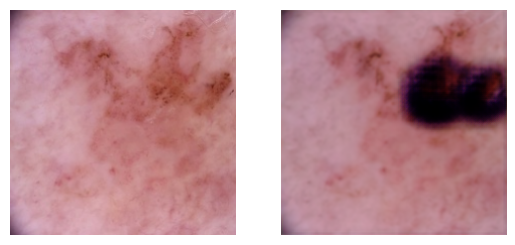

11338.016561293887
[0.10260152 0.11629046 0.1979855  0.10170895 0.10348774 0.27622515
 0.10170068]
5


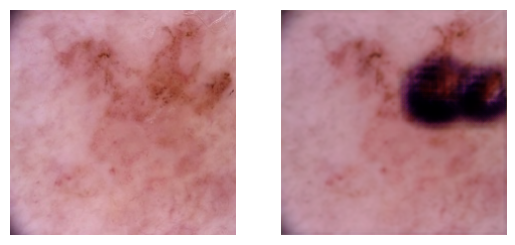

10495.636286076766
[0.10302637 0.11593826 0.19517058 0.10219126 0.10394208 0.2775483
 0.10218316]
5


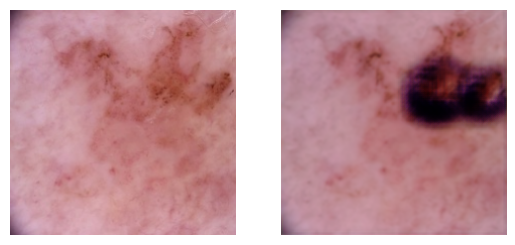

9608.90022759365
[0.10354073 0.11557634 0.19172737 0.10276907 0.1044934  0.27913204
 0.10276107]
5


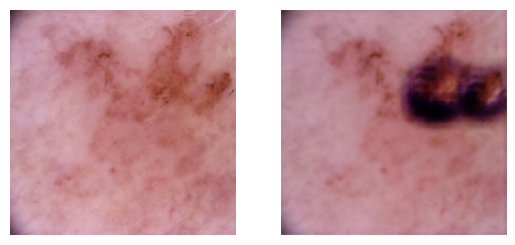

8758.166631152664
[0.10414841 0.11522485 0.18761908 0.10344442 0.10514521 0.28098157
 0.10343648]
5


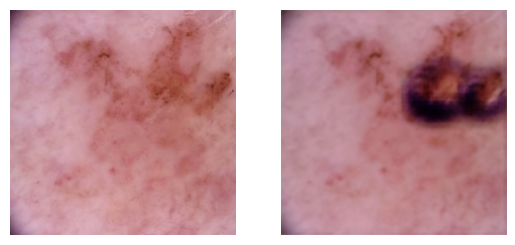

7976.525675696198


In [ ]:
index = 25

for exp in np.arange(1.0, 2.1, 0.05):
  epsilon = -10**(-exp)
  inputs = [X[index:index+1], epsilon * np.ones([1, 28, 28, 512])]
  outputs = model.predict(inputs, verbose=0)

  output_img = outputs[0][0]
  output_class = outputs[1]

  print(output_class[0])
  print(output_class.argmax())
  plt.subplot(1, 2, 1)
  plt.axis('off')
  plt.imshow(cv2.cvtColor((X[index]*255).astype(np.uint8), cv2.COLOR_BGR2RGB))
  plt.subplot(1, 2, 2)
  plt.axis('off')
  plt.imshow(cv2.cvtColor((output_img*255).astype(np.uint8), cv2.COLOR_BGR2RGB))
  plt.show()
  print(np.sum((X[0]-output_img)**2))

[0.11415274 0.11431788 0.1146734  0.11414769 0.1183643  0.3102088
 0.11413524]
5


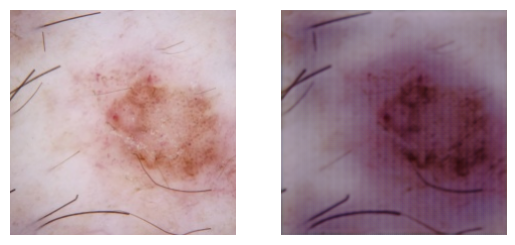

13926.685054625093
[0.11415388 0.11432057 0.11468013 0.11414861 0.11834907 0.31021148
 0.11413622]
5


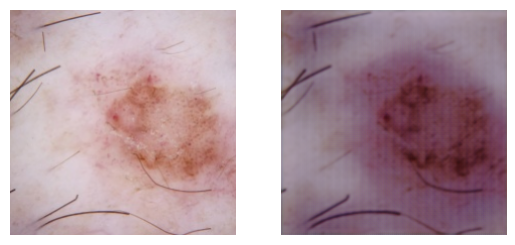

11906.97425322726
[0.11415523 0.11432375 0.11468828 0.11414968 0.11833102 0.31021467
 0.11413738]
5


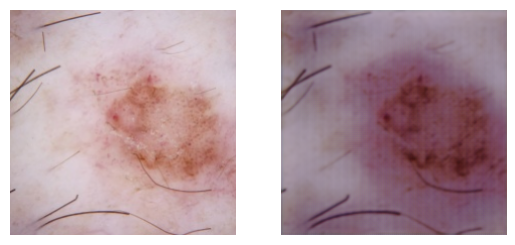

10340.71235425627
[0.11415683 0.11432751 0.11469824 0.11415093 0.11830932 0.3102184
 0.11413873]
5


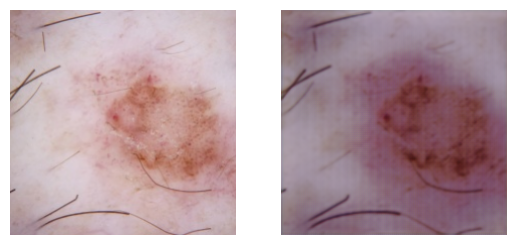

9066.695744027013
[0.11415875 0.114332   0.11471053 0.11415246 0.11828303 0.31022286
 0.11414036]
5


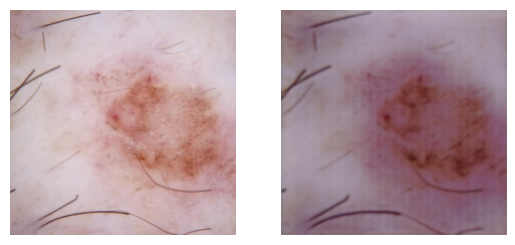

7968.052504613558
[0.11416102 0.11433737 0.11472581 0.11415426 0.11825105 0.3102282
 0.11414228]
5


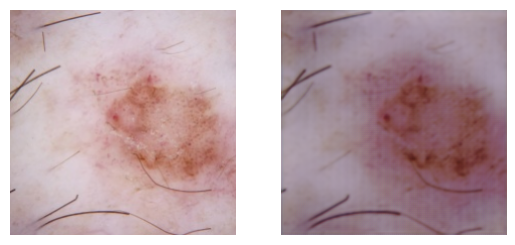

6964.226977538203
[0.11416371 0.11434378 0.11474477 0.11415638 0.11821239 0.3102344
 0.11414453]
5


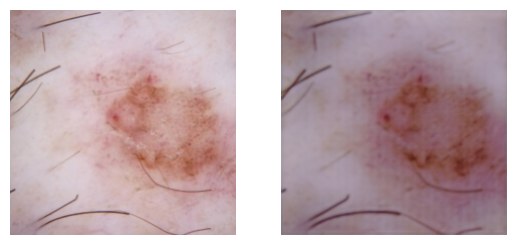

6038.548539219897
[0.1141668  0.11435138 0.11476829 0.11415879 0.11816608 0.31024152
 0.1141471 ]
5


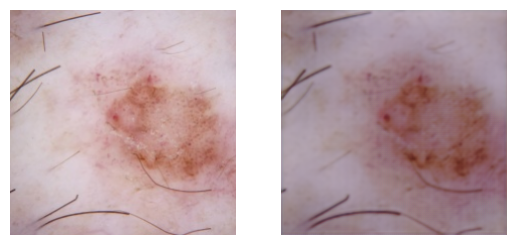

5258.9776241086975
[0.11417024 0.11436028 0.11479735 0.11416144 0.11811143 0.31024936
 0.11414993]
5


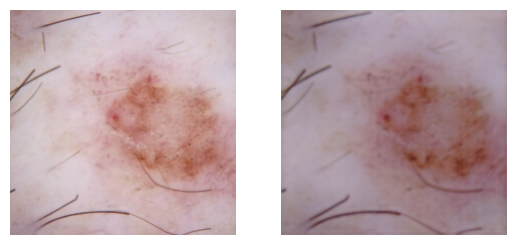

4626.415907400662
[0.11417391 0.11437054 0.11483292 0.11416417 0.11804804 0.31025752
 0.11415286]
5


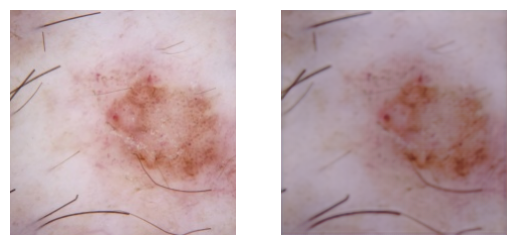

4092.0158190495404
[0.11417761 0.11438219 0.11487623 0.11416681 0.11797598 0.31026545
 0.11415572]
5


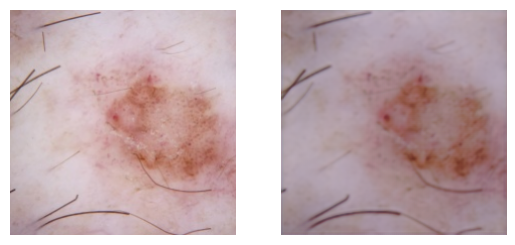

3654.20869035319
[0.11418104 0.11439516 0.11492845 0.11416905 0.11789576 0.31027234
 0.11415818]
5


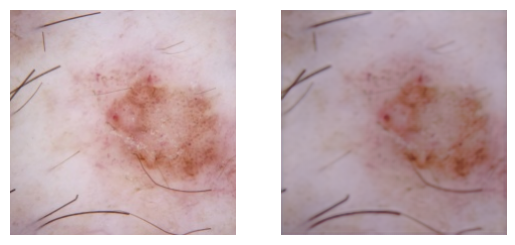

3301.2710120461275
[0.1141839  0.11440931 0.11499087 0.11417055 0.11780836 0.3102771
 0.1141599 ]
5


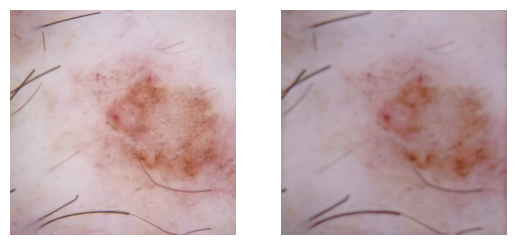

2992.541808721274
[0.11418571 0.1144244  0.11506478 0.11417086 0.11771514 0.3102787
 0.11416043]
5


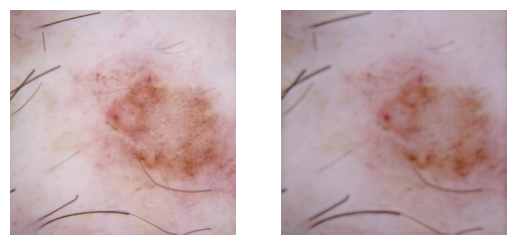

2714.4494750805434
[0.11418606 0.11444011 0.11515146 0.11416957 0.11761768 0.3102758
 0.11415936]
5


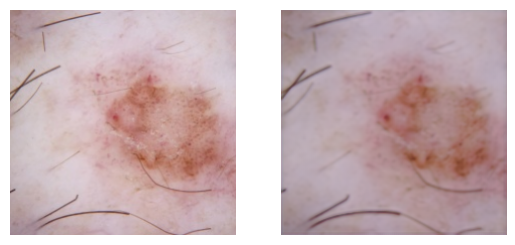

2486.287662119068
[0.11418451 0.11445609 0.11525203 0.11416622 0.11751767 0.31026724
 0.11415622]
5


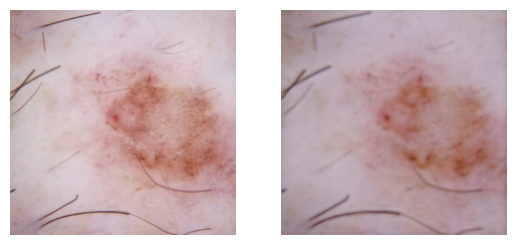

2304.9646235856976
[0.1141807  0.11447199 0.11536755 0.11416047 0.11741669 0.31025198
 0.11415065]
5


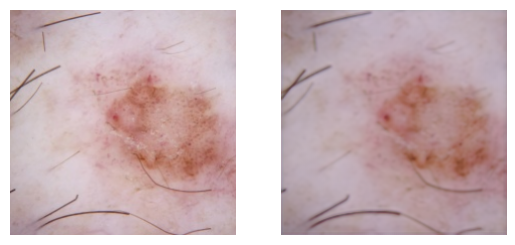

2190.191662785723
[0.11417428 0.1144874  0.11549859 0.114152   0.11731615 0.31022918
 0.11414233]
5


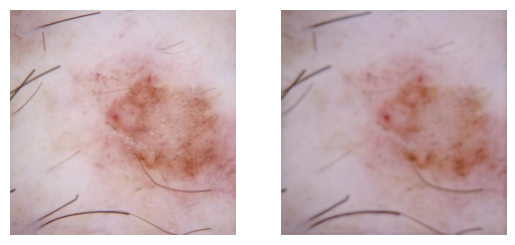

2119.8624882087447
[0.11416511 0.11450203 0.11564554 0.11414064 0.11721721 0.3101984
 0.11413109]
5


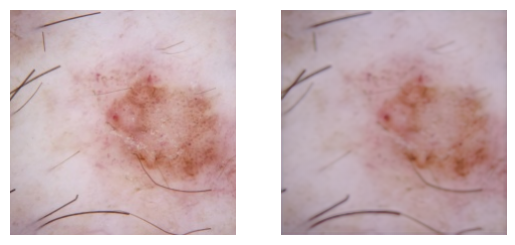

2096.1549216676367
[0.11415309 0.11451555 0.11580807 0.11412633 0.11712073 0.3101594
 0.11411689]
5


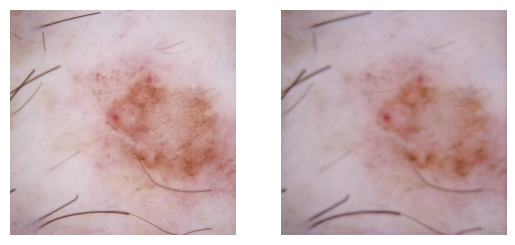

2076.5412043523843
[0.11413824 0.11452772 0.11598545 0.11410911 0.11702735 0.3101124
 0.11409976]
5


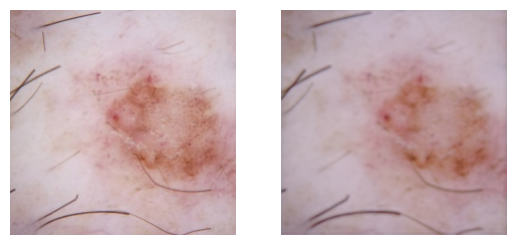

2056.4421595892422
[0.11412076 0.11453841 0.11617637 0.1140892  0.1169375  0.3100579
 0.11407989]
5


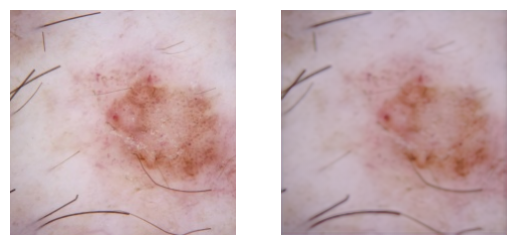

2038.4476351754565


In [ ]:
index = 30

for exp in np.arange(1.0, 2.1, 0.05):
  epsilon = -10**(-exp)
  inputs = [X[index:index+1], epsilon * np.ones([1, 28, 28, 512])]
  outputs = model.predict(inputs, verbose=0)

  output_img = outputs[0][0]
  output_class = outputs[1]

  print(output_class[0])
  print(output_class.argmax())
  plt.subplot(1, 2, 1)
  plt.axis('off')
  plt.imshow(cv2.cvtColor((X[index]*255).astype(np.uint8), cv2.COLOR_BGR2RGB))
  plt.subplot(1, 2, 2)
  plt.axis('off')
  plt.imshow(cv2.cvtColor((output_img*255).astype(np.uint8), cv2.COLOR_BGR2RGB))
  plt.show()
  print(np.sum((X[0]-output_img)**2))